<a href="https://colab.research.google.com/github/ysatwani/Explanability_in_AI/blob/main/explanability_in_AI.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install catboost -q
!pip install shap -q
!pip install dalex -q

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from imblearn.over_sampling import SMOTE
from numpy.random import RandomState
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import *
from sklearn.model_selection import *
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV
import catboost
from catboost import CatBoostClassifier
from sklearn.linear_model import LogisticRegression

/usr/local/lib/python3.7/dist-packages/sklearn/externals/six.py:31: FutureWarning: The module is deprecated in version 0.21 and will be removed in version 0.23 since we've dropped support for Python 2.7. Please rely on the official version of six (https://pypi.org/project/six/).
  "(https://pypi.org/project/six/).", FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.neighbors.base module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.neighbors. Anything that cannot be imported from sklearn.neighbors is now part of the private API.
  warnings.warn(message, FutureWarning)


In [3]:
df = pd.read_csv("/content/BankChurners.csv")
df.head()

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2
0,768805383,Existing Customer,45,M,3,High School,Married,$60K - $80K,Blue,39,5,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061,0.000093,0.99991
1,818770008,Existing Customer,49,F,5,Graduate,Single,Less than $40K,Blue,44,6,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105,0.000057,0.99994
2,713982108,Existing Customer,51,M,3,Graduate,Married,$80K - $120K,Blue,36,4,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000,0.000021,0.99998
3,769911858,Existing Customer,40,F,4,High School,Unknown,Less than $40K,Blue,34,3,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760,0.000134,0.99987
4,709106358,Existing Customer,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,5,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000,0.000022,0.99998


In [4]:
df.drop("CLIENTNUM",axis=1,inplace=True)
df.drop("Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1",axis=1,inplace=True)
df.drop("Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2",axis=1,inplace=True)

In [5]:
df['Attrition_Flag'].value_counts()#class imbalancy

Existing Customer    8500
Attrited Customer    1627
Name: Attrition_Flag, dtype: int64

In [6]:
x = df.drop('Attrition_Flag',axis=1)

In [7]:
x = pd.get_dummies(x,drop_first=True)

In [8]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
y = le.fit_transform(df["Attrition_Flag"])

In [9]:
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.25, random_state=27,stratify=y)
sm = SMOTE(random_state=27, ratio=1.0)
X_train, y_train = sm.fit_sample(X_train, y_train)

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function safe_indexing is deprecated; safe_indexing is deprecated in version 0.22 and will be removed in version 0.24.
  warnings.warn(msg, category=FutureWarning)


In [10]:
print(len(X_train))
print(len(y_train))
print(pd.DataFrame(y_train).value_counts())
pd.DataFrame(y_test).value_counts()


12750
12750
1    6375
0    6375
dtype: int64


1    2125
0     407
dtype: int64

In [11]:
from sklearn.model_selection import KFold
from sklearn.linear_model import LogisticRegression
import numpy as np
from sklearn.model_selection import GridSearchCV
log_class=LogisticRegression()
grid={'C':10.0 **np.arange(-2,3),'penalty':['l1','l2']}
cv=KFold(n_splits=10,random_state=None,shuffle=False)
clf=GridSearchCV(log_class,grid,cv=cv,n_jobs=-1,scoring='f1_macro')
clf.fit(X_train,y_train)
y_pred=clf.predict(X_test)
print(confusion_matrix(y_test,y_pred))
#print(accuracy_score(y_test,y_pred))
print(classification_report(y_test,y_pred))

[[ 328   79]
 [ 331 1794]]
              precision    recall  f1-score   support

           0       0.50      0.81      0.62       407
           1       0.96      0.84      0.90      2125

    accuracy                           0.84      2532
   macro avg       0.73      0.83      0.76      2532
weighted avg       0.88      0.84      0.85      2532



/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:940: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)


In [12]:

rf_class=RandomForestClassifier()
param_grid = { 
    'n_estimators': [200, 700],
    'max_features': ['auto', 'sqrt', 'log2']
}
cv=KFold(n_splits=10,random_state=None,shuffle=False)
clf=GridSearchCV(rf_class,param_grid,cv=cv)
clf.fit(X_train,y_train)
y_pred=clf.predict(X_test)
print(confusion_matrix(y_test,y_pred))
#print(accuracy_score(y_test,y_pred))
print(classification_report(y_test,y_pred))

[[ 332   75]
 [  40 2085]]
              precision    recall  f1-score   support

           0       0.89      0.82      0.85       407
           1       0.97      0.98      0.97      2125

    accuracy                           0.95      2532
   macro avg       0.93      0.90      0.91      2532
weighted avg       0.95      0.95      0.95      2532



In [15]:
import catboost
from catboost import CatBoostClassifier

In [16]:
params = {'task_type':'GPU','iterations':1000,'learning_rate':0.1,
           'depth':2,'eval_metric':'AUC','verbose':100,
           'random_seed': 1 }
cat_model1 = CatBoostClassifier(**params)
cat_model1.fit(X_train, y_train,eval_set=(X_test, y_test),use_best_model=True,early_stopping_rounds=50,plot=True )

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.8648270	test: 0.8485498	best: 0.8485498 (0)	total: 21ms	remaining: 21s
100:	learn: 0.9971416	test: 0.9818309	best: 0.9818309 (100)	total: 1.78s	remaining: 15.9s
200:	learn: 0.9982717	test: 0.9869542	best: 0.9869542 (200)	total: 3.42s	remaining: 13.6s
300:	learn: 0.9987050	test: 0.9889325	best: 0.9889498 (299)	total: 5.17s	remaining: 12s
400:	learn: 0.9989932	test: 0.9906923	best: 0.9906923 (400)	total: 6.94s	remaining: 10.4s
500:	learn: 0.9991641	test: 0.9914600	best: 0.9914600 (500)	total: 8.63s	remaining: 8.59s
600:	learn: 0.9992844	test: 0.9919017	best: 0.9919098 (597)	total: 10.4s	remaining: 6.89s
700:	learn: 0.9993589	test: 0.9922336	best: 0.9922625 (688)	total: 12.2s	remaining: 5.19s
800:	learn: 0.9994074	test: 0.9924775	best: 0.9924775 (800)	total: 13.9s	remaining: 3.46s
900:	learn: 0.9994637	test: 0.9924787	best: 0.9925504 (856)	total: 15.7s	remaining: 1.72s
bestTest = 0.9925503731
bestIteration = 856
Shrink model to first 857 iterations.


In [17]:
y_pred = cat_model1.predict(X_test)
cm_cat = confusion_matrix(y_test,y_pred)
print(confusion_matrix(y_test,y_pred))
print(classification_report(y_test,y_pred))

[[ 357   50]
 [  23 2102]]
              precision    recall  f1-score   support

           0       0.94      0.88      0.91       407
           1       0.98      0.99      0.98      2125

    accuracy                           0.97      2532
   macro avg       0.96      0.93      0.95      2532
weighted avg       0.97      0.97      0.97      2532



#SHAP

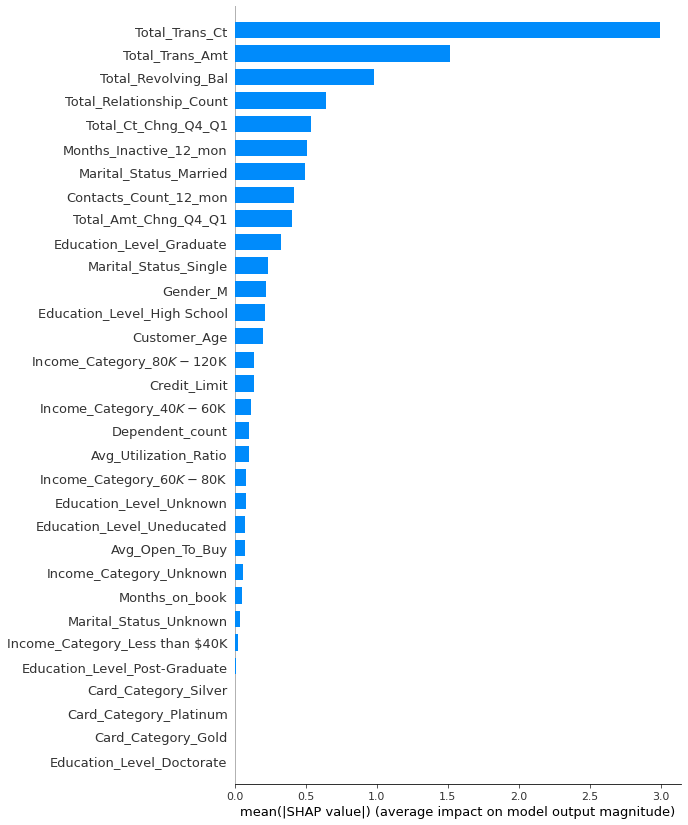

In [18]:
import shap
shap_values = shap.TreeExplainer(cat_model1).shap_values(X_train)
shap.summary_plot(shap_values, X_train, plot_type="bar",max_display=32,feature_names=x.columns)
#Top 4 Features:
#Total_Trans_Ct
#Total_Trans_Amt
#Total_Revolving_Bal
#Totla_Relationship_count.

In [19]:
from catboost import CatBoostClassifier, Pool
shap_values = cat_model1.get_feature_importance(Pool(X_test, label=y_test) ,type="ShapValues")
expected_value = shap_values[0,-1]
shap_values = shap_values[:,:-1]

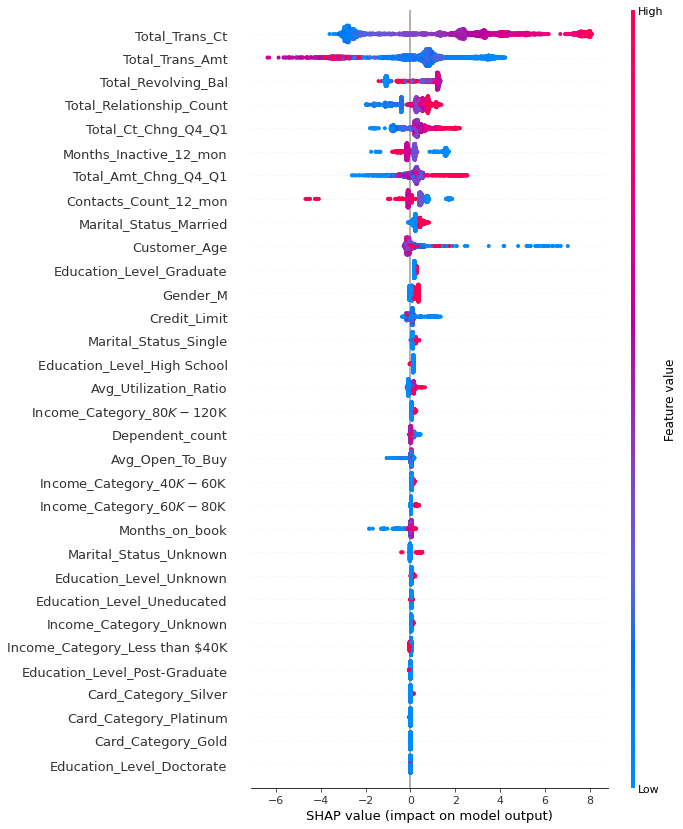

In [20]:
shap.summary_plot(shap_values, X_test,max_display=32)
#A higher value of Total_Trans_Ct leads to positive prediction.
# A lower value of Total_Trans_Amt leads to positive predictions.
# There is a presence of a higher value in Contacts_Count_12_mon that is pushing to an extreme negative prediction.
# There is a presence of a Lower value in Customer_Age that is pushing to an extreme positive prediction.
# Card-Category_platinium ,Card-Category_Gold,Education_Level_Doctrate and more features below in Y-axis that can be dropped as they don't provide 
# significant contribution in the prediction of the model.
# 1 Denotes existing customer
# 0 Denotes churned customer

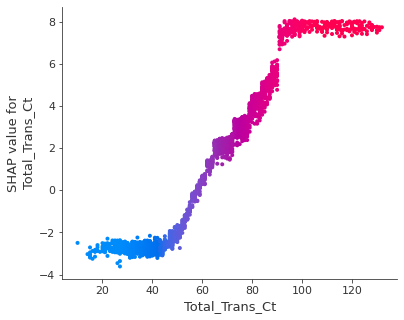

In [21]:
shap.dependence_plot("Total_Trans_Ct", shap_values, X_test,interaction_index= 'Total_Trans_Ct')
# Prediction - 1
# Threshold value for total_trans_ct > 60

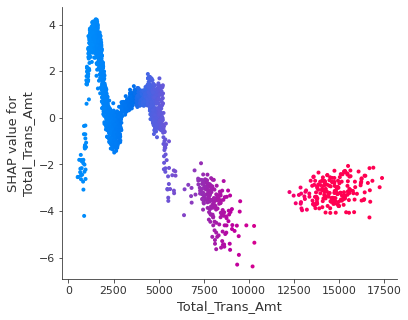

In [22]:
shap.dependence_plot('Total_Trans_Amt', shap_values, X_test,interaction_index='Total_Trans_Amt')
# prediction 1
# Threshold value for Trans_amt between 1500 and 5000

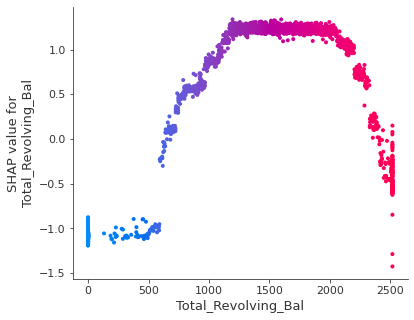

In [23]:
shap.dependence_plot('Total_Revolving_Bal', shap_values, X_test,interaction_index='Total_Revolving_Bal')
# prediction 1
# Threshold value for revolving bal between 700 and 2300

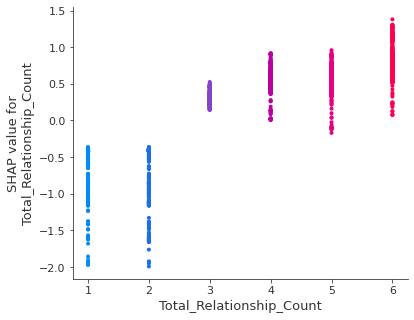

In [24]:
shap.dependence_plot('Total_Relationship_Count', shap_values, X_test,interaction_index='Total_Relationship_Count')
# prediction 1
# Threshold value for Relationship count>=3

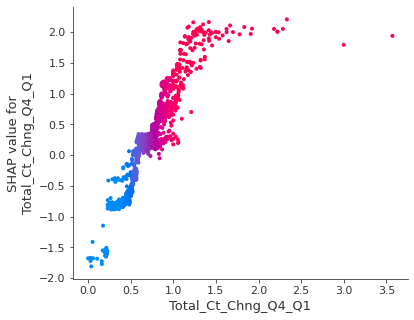

In [25]:
shap.dependence_plot('Total_Ct_Chng_Q4_Q1', shap_values, X_test,interaction_index='Total_Ct_Chng_Q4_Q1')
# prediction 1
# Threshold value for ct_chng_q4_q1 >0.7

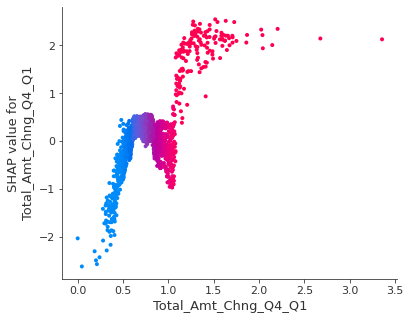

In [26]:
shap.dependence_plot('Total_Amt_Chng_Q4_Q1', shap_values, X_test,interaction_index='Total_Amt_Chng_Q4_Q1')
# prediction 1
# Threshold value for Total amt chng >1.0

#instance selection


In [27]:
a = X_test.copy(deep=False)
a['y_test'] = y_test
a['y_pred'] = y_pred
a.reset_index(inplace=True)

In [28]:
shapDF =pd.DataFrame(shap_values,columns=x.columns)
shapDF['y_test'] = y_test
shapDF['y_pred'] = y_pred

In [29]:
#True negatives
shapDF.loc[ shapDF.Total_Trans_Amt.between(-6,-4) & shapDF.Total_Trans_Ct.between(-0.5,0.5)][['Total_Trans_Ct','Total_Trans_Amt','y_test','y_pred']]

,Total_Trans_Ct,Total_Trans_Amt,y_test,y_pred
159,-0.055411,-4.630131,0,0
990,-0.490049,-4.617869,0,0
1362,-0.169217,-4.509663,0,0
1684,0.303146,-4.643502,0,0


In [30]:
#true Positives
shapDF.loc[ shapDF.Total_Trans_Ct.between(-0.5,0.5)][['Total_Trans_Ct','Total_Trans_Amt','y_test','y_pred']].head()

,Total_Trans_Ct,Total_Trans_Amt,y_test,y_pred
50,0.178789,2.930237,1,1
53,0.036260,0.462268,1,1
65,0.186797,2.530782,1,1
90,-0.108388,0.068420,1,1
131,-0.093239,0.625223,1,1


In [31]:
#False Positive
shapDF.loc[ shapDF.Total_Trans_Ct.between(-0.5,0.5) & shapDF.y_test.between(0,0) & shapDF.y_pred.between(1,1)][['Total_Trans_Ct','Total_Trans_Amt','y_test','y_pred']].head()

,Total_Trans_Ct,Total_Trans_Amt,y_test,y_pred
252,-0.028622,-0.212908,0,1
264,0.394816,-0.776284,0,1
1228,-0.340826,-0.426404,0,1
1451,0.117756,0.497937,0,1
1536,-0.195898,0.793408,0,1


In [32]:
#False Negative
shapDF.loc[shapDF.Total_Trans_Ct.between(-1,1) & shapDF.y_test.between(1,1) & shapDF.y_pred.between(0,0)][['Total_Trans_Ct','Total_Trans_Amt','y_test','y_pred']].head()

,Total_Trans_Ct,Total_Trans_Amt,y_test,y_pred
207,-0.301738,0.448195,1,0
1197,-0.952344,0.434289,1,0
1744,0.215900,-1.104757,1,0


#LIME

In [ ]:
!pip install lime -q

In [34]:
import lime
import lime.lime_tabular
explain = lime.lime_tabular.LimeTabularExplainer(X_test.to_numpy(), feature_names=x.columns, class_names=['Churned','Existing'], discretize_continuous=True)

#DALEX

In [ ]:
import dalex as dx
exp = dx.Explainer(cat_model1, X_test, y_test)

#Anchors 


In [ ]:
!pip install anchor-exp -q
from anchor import utils
from anchor import anchor_tabular

In [37]:
ex= anchor_tabular.AnchorTabularExplainer(['0','1'],x.columns, X_train)
ex_p = ex.explain_instance(X_test.to_numpy()[159], cat_model1.predict, threshold=0.95)
ex_p.show_in_notebook()

#True Negatives

In [38]:
a.loc[159:159,:]

,index,Customer_Age,Dependent_count,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Gender_M,Education_Level_Doctorate,Education_Level_Graduate,Education_Level_High School,Education_Level_Post-Graduate,Education_Level_Uneducated,Education_Level_Unknown,Marital_Status_Married,Marital_Status_Single,Marital_Status_Unknown,Income_Category_$40K - $60K,Income_Category_$60K - $80K,Income_Category_$80K - $120K,Income_Category_Less than $40K,Income_Category_Unknown,Card_Category_Gold,Card_Category_Platinum,Card_Category_Silver,y_test,y_pred
159,9708,36,2,36,2,3,3,6071.0,0,6071.0,0.912,9338,59,0.903,0.0,0,0,0,0,0,0,1,0,1,0,0,0,0,1,0,0,0,0,0,0


In [39]:
shap.initjs()
shap.force_plot(expected_value, shap_values[159,:], X_test.iloc[159,:])
#Top 2 fetures leading to a negative prediction :
#Total Trans_Amt
#Total_Revolving_bal
#Total_relationship_Count
#Top 2 fetures leading to a positive prediction :
#Total_Ct_change_Q4_Q1
#Customer_Age

In [40]:
expr = explain.explain_instance(X_test.to_numpy()[159], cat_model1.predict_proba, num_features=9)
expr.show_in_notebook()
#Top 2 fetures leading to a negative prediction :
#Total_Trans_Amt 
#Total_Revolving_Bal
#Top 2 fetures leading to a positive prediction :
#Total_Ct_change_Q4_Q1
#Customer_Age

In [41]:
explaination = exp.predict_parts(X_test.to_numpy()[159], type = 'break_down_interactions')
explaination.plot(max_vars=9)
#Top 2 fetures leading to a negative prediction :
#Total_Trans_Amt 
#Total_Trans_Ct
#Top 2 fetures leading to a positive prediction :
#Total_RelationShip_Count
#Total_Ct_change_Q4_Q1

In [42]:
expr = ex.explain_instance(X_test.to_numpy()[159], cat_model1.predict, threshold=0.95)
print("Reason : ",expr.names())
#Top 2 fetures leading to a negative prediction :
#Total_Trans_Amt 
#Total_Revolving_Bal
##Total_Transaction_Amt is the common feature stated by all 4 frameworks fo 0 prediction.

Reason :  ['Total_Trans_Amt > 4588.00', 'Avg_Utilization_Ratio <= 0.00', 'Total_Trans_Ct <= 73.00', 'Total_Relationship_Count <= 2.45']


In [43]:
a.loc[990:990,:]

,index,Customer_Age,Dependent_count,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Gender_M,Education_Level_Doctorate,Education_Level_Graduate,Education_Level_High School,Education_Level_Post-Graduate,Education_Level_Uneducated,Education_Level_Unknown,Marital_Status_Married,Marital_Status_Single,Marital_Status_Unknown,Income_Category_$40K - $60K,Income_Category_$60K - $80K,Income_Category_$80K - $120K,Income_Category_Less than $40K,Income_Category_Unknown,Card_Category_Gold,Card_Category_Platinum,Card_Category_Silver,y_test,y_pred
990,9898,59,1,54,2,5,4,15633.0,0,15633.0,0.984,8660,58,0.758,0.0,1,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0


In [44]:
shap.initjs()
shap.force_plot(expected_value, shap_values[990,:], X_test.iloc[990	,:])
#Top 2 fetures leading to a negative prediction :
#Total Trans_Amt
#Total_Revolving_bal
#Top 2 fetures leading to a positive prediction :
#Education_level_graduate = 1
#Income_category_80k-120k =1
#customer has a high income category still he is leaving the services.

In [45]:
expr = explain.explain_instance(X_test.to_numpy()[990], cat_model1.predict_proba, num_features=9)
expr.show_in_notebook()
#Top 2 fetures leading to a negative prediction :
#Total Trans_Amt
#Total_Revolving_bal
#Total_relationship_Count
#Top 2 fetures leading to a positive prediction :
#Card_category_platnium = 0
#bank must try to shift this customer to a plantnium category 
#customer is also inactive since 5 years

In [46]:
explaination = exp.predict_parts(X_test.to_numpy()[990], type = 'break_down_interactions')
explaination.plot(max_vars=9)
#Top 2 fetures leading to a negative prediction :
#Total Trans_Amt
#Total_trans_Ct
#Total_relationship_Count
#Top  fetures leading to a positive prediction :
#Total_Relationship_count

In [47]:
expr = ex.explain_instance(X_test.to_numpy()[990], cat_model1.predict, threshold=0.95)
print("Reason : ",expr.names())
#Top 2 fetures leading to a negative prediction :
#Total Trans_Amt
#Contacts_Count_12_mon
##Looking at the explanation of all 4 frameworks still Total_tran_Amt is the common most important feature.

Reason :  ['Total_Trans_Amt > 4588.00', 'Contacts_Count_12_mon > 3.00', 'Total_Relationship_Count <= 2.45']


In [48]:
a.loc[1362:1362,:]

,index,Customer_Age,Dependent_count,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Gender_M,Education_Level_Doctorate,Education_Level_Graduate,Education_Level_High School,Education_Level_Post-Graduate,Education_Level_Uneducated,Education_Level_Unknown,Marital_Status_Married,Marital_Status_Single,Marital_Status_Unknown,Income_Category_$40K - $60K,Income_Category_$60K - $80K,Income_Category_$80K - $120K,Income_Category_Less than $40K,Income_Category_Unknown,Card_Category_Gold,Card_Category_Platinum,Card_Category_Silver,y_test,y_pred
1362,9158,58,2,46,1,3,1,10286.0,0,10286.0,0.908,8199,59,0.903,0.0,1,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,0


In [49]:
shap.initjs()
shap.force_plot(expected_value, shap_values[1362,:], X_test.iloc[1362	,:])
#Top 2 fetures leading to a negative prediction :
#Total Trans_Amt
#Total_Revolving_bal
#Top 2 fetures leading to a positive prediction :
#Contacts_count_12_mon = 1
#Total_Trans_Ct_Q4-Q1.

In [50]:
expr = explain.explain_instance(X_test.to_numpy()[1362], cat_model1.predict_proba, num_features=9)
expr.show_in_notebook()
#Top 2 fetures leading to a negative prediction :
#Total Trans_Amt
#Total_Revolving_bal
#Top 2 fetures leading to a positive prediction :
#Total_Trans_Ct_Q4-Q1.
#Card_Category_gold = 0.

In [51]:
explaination = exp.predict_parts(X_test.to_numpy()[1362], type = 'break_down_interactions')
explaination.plot(max_vars=9)
#Top 2 fetures leading to a negative prediction :
#Total Trans_Amt
#Total_Trans_Ct
#Top 2 fetures leading to a positive prediction :
#Total_Trans_Ct_Q4-Q1.
#Contacts_count_12_mons.

In [52]:
expr = ex.explain_instance(X_test.to_numpy()[1362], cat_model1.predict, threshold=0.95)
print("Reason : ",expr.names())
#Top 2 fetures leading to a negative prediction :
#Total Trans_Amt
#Total_Trans_Ct
## still Total_trans_Amt is a common feature leading to negative prediction having a 
## high feature value , which satisfies shap global prediction for total trans amt.

Reason :  ['Total_Trans_Amt > 4588.00', 'Avg_Utilization_Ratio <= 0.00', 'Total_Trans_Ct <= 73.00', 'Total_Relationship_Count <= 2.45']


#True Positive

In [53]:
a.loc[50:50,:]

,index,Customer_Age,Dependent_count,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Gender_M,Education_Level_Doctorate,Education_Level_Graduate,Education_Level_High School,Education_Level_Post-Graduate,Education_Level_Uneducated,Education_Level_Unknown,Marital_Status_Married,Marital_Status_Single,Marital_Status_Unknown,Income_Category_$40K - $60K,Income_Category_$60K - $80K,Income_Category_$80K - $120K,Income_Category_Less than $40K,Income_Category_Unknown,Card_Category_Gold,Card_Category_Platinum,Card_Category_Silver,y_test,y_pred
50,577,47,4,36,4,1,1,19665.0,706,18959.0,1.317,1110,58,0.349,0.036,1,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,1


In [54]:
shap.initjs()
shap.force_plot(expected_value, shap_values[50,:], X_test.iloc[50	,:])
#Top 2 fetures leading to a positive prediction :
#Total Trans_Amt
#Total_Amt_Change_Q4-Q1
#Top 2 fetures leading to a negative prediction :
#Total_ct_Change_Q4-Q1
#Customer_Age =47

In [55]:
expr = explain.explain_instance(X_test.to_numpy()[50], cat_model1.predict_proba, num_features=9)
expr.show_in_notebook()
#Top 2 fetures leading to a positive prediction :
#Total Trans_Amt
#Marital_status_Marries = 1.0.
#Top 2 fetures leading to a negative prediction :
#Total_ct_Change_Q4-Q1.
#Total_Trans_Ct.

In [56]:
explaination = exp.predict_parts(X_test.to_numpy()[50], type = 'break_down_interactions')
explaination.plot(max_vars=9)
#Top 2 fetures leading to a positive prediction :
#Total Trans_Amt
#Total_Amt_Change_Q4-Q1
#Top 2 fetures leading to a negative prediction :
#Total_ct_Change_Q4-Q1
#Customer_Age =47

In [57]:
expr = ex.explain_instance(X_test.to_numpy()[50], cat_model1.predict, threshold=0.95)
print("Reason : ",expr.names())
#Top 2 fetures leading to a positive prediction :
#Total Trans_Ct
#Contacts_count_12_mon
## inferences given by Anchors are very different from all other frameworks.
## #Total Trans_Amt #Total_Amt_Change_Q4-Q1 are the most important features leading to 1 prediction for this instance.

Reason :  ['Total_Trans_Ct > 51.00', 'Contacts_Count_12_mon <= 2.00', 'Months_Inactive_12_mon <= 2.00', 'Avg_Utilization_Ratio > 0.00']


In [58]:
a.loc[65:65,:]

,index,Customer_Age,Dependent_count,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Gender_M,Education_Level_Doctorate,Education_Level_Graduate,Education_Level_High School,Education_Level_Post-Graduate,Education_Level_Uneducated,Education_Level_Unknown,Marital_Status_Married,Marital_Status_Single,Marital_Status_Unknown,Income_Category_$40K - $60K,Income_Category_$60K - $80K,Income_Category_$80K - $120K,Income_Category_Less than $40K,Income_Category_Unknown,Card_Category_Gold,Card_Category_Platinum,Card_Category_Silver,y_test,y_pred
65,950,39,1,22,4,3,3,9204.0,845,8359.0,0.673,1820,58,0.611,0.092,1,0,0,0,0,1,0,0,1,0,0,1,0,0,0,0,0,0,1,1


In [59]:
shap.initjs()
shap.force_plot(expected_value, shap_values[65,:], X_test.iloc[65	,:])
#Top 2 fetures leading to a positive prediction :
#Total Trans_Amt
#Total_Relationship_count.
#Top 2 fetures leading to a negative prediction :
#Contact_count_12_months
#Months_inactive_12_months = 3.

In [60]:
expr = explain.explain_instance(X_test.to_numpy()[65], cat_model1.predict_proba, num_features=9)
expr.show_in_notebook()
#Top 2 fetures leading to a positive prediction :
#Total Trans_Amt
#Total_relationship_count.
#Top 2 fetures leading to a negative prediction :
#card_category_platnium = 0
#Total_Trans_Ct.

In [61]:
explaination = exp.predict_parts(X_test.to_numpy()[65], type = 'break_down_interactions')
explaination.plot(max_vars=9)
#Top 2 fetures leading to a positive prediction :
#Total Trans_Amt
#Total_revolving_bal.
#Top 2 fetures leading to a negative prediction :
#Months_Inactive_12mon =3
#Contact_count_12_months.

In [62]:
expr = ex.explain_instance(X_test.to_numpy()[65], cat_model1.predict, threshold=0.95)
print("Reason : ",expr.names())
#Top 2 fetures leading to a positive prediction :
#Total Trans_Amt
#Total_Trans_Ct.
## Total_trans_Amt is the common feature leading to 1 prediction.

Reason :  ['Total_Trans_Ct > 51.00', 'Avg_Utilization_Ratio > 0.09', 'Income_Category_Less than $40K <= 0.00', 'Dependent_count <= 1.59', 'Months_on_book <= 36.00']


In [63]:
a.loc[131:131,:]

,index,Customer_Age,Dependent_count,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Gender_M,Education_Level_Doctorate,Education_Level_Graduate,Education_Level_High School,Education_Level_Post-Graduate,Education_Level_Uneducated,Education_Level_Unknown,Marital_Status_Married,Marital_Status_Single,Marital_Status_Unknown,Income_Category_$40K - $60K,Income_Category_$60K - $80K,Income_Category_$80K - $120K,Income_Category_Less than $40K,Income_Category_Unknown,Card_Category_Gold,Card_Category_Platinum,Card_Category_Silver,y_test,y_pred
131,2716,46,2,40,4,2,4,7949.0,1514,6435.0,0.857,3355,58,0.657,0.19,1,0,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,1


In [64]:
shap.initjs()
shap.force_plot(expected_value, shap_values[131,:], X_test.iloc[131	,:])
#Top 2 fetures leading to a positive prediction :
#Total_Revolving_balance.
#Total_relationship_count.
#Top 2 fetures leading to a negative prediction :
#customer_age
#Total_Trans_Ct.

In [65]:
expr = explain.explain_instance(X_test.to_numpy()[131], cat_model1.predict_proba, num_features=9)
expr.show_in_notebook()
#Top 2 fetures leading to a positive prediction :
#card_Category_platnium=0 - for customer staying doesn't makes sense
#Total_revolving_Bal.
#Top 2 fetures leading to a negative prediction :
#Total_Trans_Ct.
#Contacts_count_12_mons

In [66]:
explaination = exp.predict_parts(X_test.to_numpy()[131], type = 'break_down_interactions')
explaination.plot(max_vars=9)
#Top 2 fetures leading to a positive prediction :
#Total_Revolving_balance.
#Total_trans_Amt.
#Top 2 fetures leading to a negative prediction :
#customer_age

In [67]:
expr = ex.explain_instance(X_test.to_numpy()[131], cat_model1.predict, threshold=0.95)
print("Reason : ",expr.names())
#Top 2 fetures leading to a positive prediction :
#Total_Revolving_balance.
#Total_trans_ct.
## Total_Revolving_balance is the common most imp feature given by all frameworks.

Reason :  ['Total_Trans_Ct > 51.00', 'Total_Revolving_Bal > 910.00', 'Months_Inactive_12_mon <= 2.00', 'Total_Trans_Amt > 2649.02']


#False Positive

In [68]:
a.loc[252:252,:]

,index,Customer_Age,Dependent_count,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Gender_M,Education_Level_Doctorate,Education_Level_Graduate,Education_Level_High School,Education_Level_Post-Graduate,Education_Level_Uneducated,Education_Level_Unknown,Marital_Status_Married,Marital_Status_Single,Marital_Status_Unknown,Income_Category_$40K - $60K,Income_Category_$60K - $80K,Income_Category_$80K - $120K,Income_Category_Less than $40K,Income_Category_Unknown,Card_Category_Gold,Card_Category_Platinum,Card_Category_Silver,y_test,y_pred
252,6335,50,2,36,3,2,2,3647.0,2517,1130.0,0.842,2935,58,0.933,0.69,0,0,0,0,0,0,1,0,1,0,0,0,0,1,0,0,0,0,0,1


In [69]:
shap.initjs()
shap.force_plot(expected_value, shap_values[252,:], X_test.iloc[252	,:])
#Top 2 fetures leading to a positive prediction :
#Total_ct_change_Q4-Q1
#contact_counts_12_mon
#Top 2 fetures leading to a negative prediction :
#Total_Revolving_Bal
#Total_trans_Amt

In [70]:
expr = explain.explain_instance(X_test.to_numpy()[252], cat_model1.predict_proba, num_features=9)
expr.show_in_notebook()
#Top 2 fetures leading to a positive prediction :
#EducationLevelPostGraduate= 0 
#Total_ct_change_Q4-Q1
#Top 2 fetures leading to a negative prediction :
#Total_Relationship_count
#Total_trans_ct

In [71]:
explaination = exp.predict_parts(X_test.to_numpy()[252], type = 'break_down_interactions')
explaination.plot(max_vars=9)
#Top 2 fetures leading to a positive prediction :
#Total_ct_change_Q4-Q1
#contact_counts_12_mon
#Top 2 fetures leading to a negative prediction :
#Total_Revolving_Bal
#Total_trans_Amt

In [72]:
expr = ex.explain_instance(X_test.to_numpy()[252], cat_model1.predict, threshold=0.95)
print("Reason : ",expr.names())
#Top 2 fetures leading to a positive prediction :
#Total_ct_change_Q4-Q1
#contact_counts_12_mon
###  #Total_ct_change_Q4-Q1  #contact_counts_12_mon are features leading to wrong prediction in this particular instance.

Reason :  ['Total_Trans_Ct > 51.00', 'Contacts_Count_12_mon <= 2.00', 'Avg_Utilization_Ratio > 0.41', 'Total_Trans_Amt > 2649.02']


In [73]:
a.loc[1228:1228,:]

,index,Customer_Age,Dependent_count,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Gender_M,Education_Level_Doctorate,Education_Level_Graduate,Education_Level_High School,Education_Level_Post-Graduate,Education_Level_Uneducated,Education_Level_Unknown,Marital_Status_Married,Marital_Status_Single,Marital_Status_Unknown,Income_Category_$40K - $60K,Income_Category_$60K - $80K,Income_Category_$80K - $120K,Income_Category_Less than $40K,Income_Category_Unknown,Card_Category_Gold,Card_Category_Platinum,Card_Category_Silver,y_test,y_pred
1228,6998,49,1,37,6,2,2,2173.0,0,2173.0,0.652,2379,57,0.781,0.0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1


In [74]:
shap.initjs()
shap.force_plot(expected_value, shap_values[1228,:], X_test.iloc[1228	,:])
#Top 2 fetures leading to a positive prediction :
#Total_Relationship_count
#contact_counts_12_mon
#Top 2 fetures leading to a negative prediction :
#Total_Revolving_Bal
#Total_trans_Amt

In [75]:
expr = explain.explain_instance(X_test.to_numpy()[1228], cat_model1.predict_proba, num_features=9)
expr.show_in_notebook()
#Top 2 fetures leading to a positive prediction :
#Total_Relationship_count
#Total_trans_amt
#Top 2 fetures leading to a negative prediction :
#Total_Revolving_Bal
#Total_trans_ct

In [76]:
explaination = exp.predict_parts(X_test.to_numpy()[1228], type = 'break_down_interactions',)
explaination.plot(max_vars=32)
#Top 2 fetures leading to a positive prediction :
#Total_Relationship_count
#Total_trans_Amt
#Top 2 fetures leading to a negative prediction :
#Total_Revolving_Bal
#Total_trans_ct
#  0.421 -
# 0.194

In [79]:
expr = ex.explain_instance(X_test.to_numpy()[1228], cat_model1.predict, threshold=0.95)
print("Reason : ",expr.names())
#Top 2 fetures leading to a positive prediction :
#Total_Relationship_count
#Total_trans_ct
## Total_Relationship_count =6 is the common feature leading to wrong prediction 

Reason :  ['Total_Trans_Ct > 51.00', 'Contacts_Count_12_mon <= 2.00', 'Months_Inactive_12_mon <= 2.00', 'Total_Amt_Chng_Q4_Q1 <= 0.85']


In [80]:
a.loc[1536:1536,:]

,index,Customer_Age,Dependent_count,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Gender_M,Education_Level_Doctorate,Education_Level_Graduate,Education_Level_High School,Education_Level_Post-Graduate,Education_Level_Uneducated,Education_Level_Unknown,Marital_Status_Married,Marital_Status_Single,Marital_Status_Unknown,Income_Category_$40K - $60K,Income_Category_$60K - $80K,Income_Category_$80K - $120K,Income_Category_Less than $40K,Income_Category_Unknown,Card_Category_Gold,Card_Category_Platinum,Card_Category_Silver,y_test,y_pred
1536,7418,46,1,24,3,3,2,2694.0,1576,1118.0,0.494,2041,57,0.9,0.585,0,0,1,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1


In [81]:
shap.initjs()
shap.force_plot(expected_value, shap_values[1536,:], X_test.iloc[1536	,:])
#Top 2 fetures leading to a positive prediction :
#Total_Relationship_count
#Total_trans_ct
## Total_Relationship_count =6 is the common feature leading to wrong prediction 

In [82]:
expr = explain.explain_instance(X_test.to_numpy()[1536], cat_model1.predict_proba, num_features=9)
expr.show_in_notebook()
#Top 2 fetures leading to a positive prediction :
#Total_Trans_Amt
#card_category_platnium = 0
#Top 2 fetures leading to a negative prediction :
#Total_relationship_count
#Total_trans_Ct

In [83]:
explaination = exp.predict_parts(X_test.to_numpy()[1536], type = 'break_down_interactions')
explaination.plot(max_vars=9)
#Top 2 fetures leading to a positive prediction :
#Total_Revolving_balance
#Total_trans_amt
#Top 2 fetures leading to a negative prediction :
##Total_Amt_change_q4-q1
#Months_Inactive_12months

In [84]:
expr = ex.explain_instance(X_test.to_numpy()[1536], cat_model1.predict, threshold=0.95)
print("Reason : ",expr.names())
#Top 2 fetures leading to a positive prediction :
#Total_Revolving_balance
#Total_ct_change_q4-q1

Reason :  ['Total_Trans_Ct > 51.00', 'Contacts_Count_12_mon <= 2.00', 'Avg_Utilization_Ratio > 0.41', 'Income_Category_Less than $40K <= 0.00']


#False Negative

In [85]:
a.loc[207:207,:]

,index,Customer_Age,Dependent_count,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Gender_M,Education_Level_Doctorate,Education_Level_Graduate,Education_Level_High School,Education_Level_Post-Graduate,Education_Level_Uneducated,Education_Level_Unknown,Marital_Status_Married,Marital_Status_Single,Marital_Status_Unknown,Income_Category_$40K - $60K,Income_Category_$60K - $80K,Income_Category_$80K - $120K,Income_Category_Less than $40K,Income_Category_Unknown,Card_Category_Gold,Card_Category_Platinum,Card_Category_Silver,y_test,y_pred
207,1735,57,2,39,3,4,3,3451.0,0,3451.0,0.744,3031,57,0.676,0.0,1,0,1,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0


In [86]:
shap.initjs()
shap.force_plot(expected_value, shap_values[207,:], X_test.iloc[207	,:])
#Top 2 fetures leading to a negative prediction :
#Total_Revolving_bal
#Months_inactive_12months = 4 _ customer is inactive since 4 years
#Top 2 fetures leading to a positive prediction :
#Total_trans_Amt
#Gender_M =1

In [87]:
expr = explain.explain_instance(X_test.to_numpy()[207], cat_model1.predict_proba, num_features=9)
expr.show_in_notebook()
#Top 2 fetures leading to a negative prediction :
#Total_Revolving_bal
#Total_Relationship_count
#Top 2 fetures leading to a positive prediction :
#Total_trans_Amt

In [88]:
explaination = exp.predict_parts(X_test.to_numpy()[207], type = 'break_down_interactions')
explaination.plot(max_vars=9)
#Top 2 fetures leading to a negative prediction :
#Total_Revolving_bal
#Months_inactive_12months = 4 _ customer is inactive since 4 years
#Top 2 fetures leading to a positive prediction :
#Total_Amt_chang_q4-q1
#Gender_M =1

In [89]:
expr = ex.explain_instance(X_test.to_numpy()[207], cat_model1.predict, threshold=0.95)
print("Reason : ",expr.names())
#Top 2 fetures leading to a negative prediction :
#Total_Revolving_Balance
#Total_trans_ct
#Avg_utilization_ratio
#Months_inactive_12months = 4 
## Total_Revoving_Balance is the common most important feature given by all the three models pushing to negative wrong prediction.

Reason :  ['Total_Trans_Ct <= 73.00', 'Avg_Utilization_Ratio <= 0.00', 'Months_Inactive_12_mon > 3.00', 'Total_Relationship_Count <= 3.54']


In [90]:
a.loc[1197:1197,:]

,index,Customer_Age,Dependent_count,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Gender_M,Education_Level_Doctorate,Education_Level_Graduate,Education_Level_High School,Education_Level_Post-Graduate,Education_Level_Uneducated,Education_Level_Unknown,Marital_Status_Married,Marital_Status_Single,Marital_Status_Unknown,Income_Category_$40K - $60K,Income_Category_$60K - $80K,Income_Category_$80K - $120K,Income_Category_Less than $40K,Income_Category_Unknown,Card_Category_Gold,Card_Category_Platinum,Card_Category_Silver,y_test,y_pred
1197,3626,42,3,37,5,3,4,8017.0,0,8017.0,0.539,3042,55,0.528,0.0,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0


In [91]:
shap.initjs()
shap.force_plot(expected_value, shap_values[1197,:], X_test.iloc[1197	,:])
#Top 2 fetures leading to a negative prediction :
#Total_Revolving_bal
#Total_Trans_ct
#Top 2 fetures leading to a positive prediction :
#Total_Relationship_count
#Total_Trans_Amt

In [92]:
expr = explain.explain_instance(X_test.to_numpy()[1197], cat_model1.predict_proba, num_features=9)
expr.show_in_notebook()
#Top 2 fetures leading to a negative prediction :
#Total_Revolving_bal
#card_category_platnium
#Top 2 fetures leading to a positive prediction :
#Total_Relationship_count
#Total_Trans_Amt

In [93]:
explaination = exp.predict_parts(X_test.to_numpy()[1197], type = 'break_down_interactions')
explaination.plot(max_vars=9)
#Top 2 fetures leading to a negative prediction :
#Total_Trans_Ct
#Total_Ct_change_Q4_Q1
#Top 2 fetures leading to a positive prediction :
#Total_Relationship_count
#Total_Trans_Amt

In [94]:
expr = ex.explain_instance(X_test.to_numpy()[1197], cat_model1.predict, threshold=0.95)
print("Reason : ",expr.names())
#Top 2 fetures leading to a negative prediction :
#Total_Trans_Ct
#Avg_utilization_ratio
#Total_Ct_change_Q4_Q1

Reason :  ['Total_Trans_Ct <= 73.00', 'Avg_Utilization_Ratio <= 0.00', 'Contacts_Count_12_mon > 3.00', 'Total_Amt_Chng_Q4_Q1 <= 0.61']


In [95]:
a.loc[1744:1744,:]

,index,Customer_Age,Dependent_count,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Gender_M,Education_Level_Doctorate,Education_Level_Graduate,Education_Level_High School,Education_Level_Post-Graduate,Education_Level_Uneducated,Education_Level_Unknown,Marital_Status_Married,Marital_Status_Single,Marital_Status_Unknown,Income_Category_$40K - $60K,Income_Category_$60K - $80K,Income_Category_$80K - $120K,Income_Category_Less than $40K,Income_Category_Unknown,Card_Category_Gold,Card_Category_Platinum,Card_Category_Silver,y_test,y_pred
1744,3387,45,2,27,6,3,3,1438.3,0,1438.3,0.683,2598,59,0.595,0.0,0,0,0,0,0,0,1,0,1,0,0,0,0,1,0,0,0,0,1,0


In [96]:
shap.initjs()
shap.force_plot(expected_value, shap_values[1744,:], X_test.iloc[1744	,:])
#Top 2 fetures leading to a negative prediction :
#Total_trans_Amt
#Total_Revolving_bal
#Top 2 fetures leading to a positive prediction :
#Total_RelationShip_count
#Marital_Status_single

In [97]:
expr = explain.explain_instance(X_test.to_numpy()[1744], cat_model1.predict_proba, num_features=9)
expr.show_in_notebook()
#Top 2 fetures leading to a negative prediction :
#Total_Revolving_bal
#Total_trans_ct
#Top 2 fetures leading to a positive prediction :
#Total_RelationShip_count
#Credit_limit

In [98]:
explaination = exp.predict_parts(X_test.to_numpy()[1744], type = 'break_down_interactions')
explaination.plot(max_vars=9)
#Top 2 fetures leading to a negative prediction :
#Total_Revolving_bal
#Total_trans_Amt
#Top 2 fetures leading to a positive prediction :
#Total_RelationShip_count

In [99]:
expr = ex.explain_instance(X_test.to_numpy()[1744], cat_model1.predict, threshold=0.95)
print("Reason : ",expr.names())
#Top 2 fetures leading to a negative prediction :
#Avg_utilization ratio
#Total_trans_ct

Reason :  ['Total_Trans_Ct <= 73.00', 'Total_Revolving_Bal <= 0.00', 'Total_Trans_Amt <= 2649.02', 'Income_Category_Less than $40K > 0.00']
